In [96]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import rcParams
from scipy import stats

In [97]:
df = pd.read_csv('data/business_loan_approved.csv')
df.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,hardship_payoff_balance_amount,hardship_last_payment_amount,disbursement_method,debt_settlement_flag,debt_settlement_flag_date,settlement_status,settlement_date,settlement_amount,settlement_percentage,settlement_term
0,68355089,NaN,24700.0,24700.0,24700.0,36 months,11.99,820.28,C,C1,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
1,67715283,NaN,16000.0,16000.0,16000.0,36 months,12.88,538.18,C,C2,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
2,68525638,NaN,14000.0,14000.0,14000.0,60 months,19.89,370.06,E,E3,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
3,68536927,NaN,10000.0,10000.0,10000.0,36 months,11.48,329.67,B,B5,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
4,68566111,NaN,10000.0,10000.0,10000.0,60 months,19.48,262.06,E,E2,...,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN


In [98]:
df['loan_status'].value_counts()

loan_status
Fully Paid                                             10836
Charged Off                                             4580
Late (31-120 days)                                       339
In Grace Period                                          111
Does not meet the credit policy. Status:Fully Paid        89
Does not meet the credit policy. Status:Charged Off       72
Late (16-30 days)                                         71
Name: count, dtype: int64

In [99]:
percentages = df['loan_status'].value_counts(normalize=True) * 100
percentages

loan_status
Fully Paid                                             67.312710
Charged Off                                            28.450739
Late (31-120 days)                                      2.105852
In Grace Period                                         0.689527
Does not meet the credit policy. Status:Fully Paid      0.552864
Does not meet the credit policy. Status:Charged Off     0.447261
Late (16-30 days)                                       0.441049
Name: proportion, dtype: float64

Change the value of loan status:
Fully paid - will be fully paid
Does not meet the credit policy. Status:Fully Paid - Will be fully paid
Rest - charged off
consider fully paid is 1, charged off is 0

In [100]:
df['loan_status'] = np.where(df['loan_status'] == 'Fully Paid', 1,
                    np.where(df['loan_status'] == 'Charged Off', 0,
                    np.where(df['loan_status'] == 'Late (31-120 days)', 0,
                    np.where(df['loan_status'] == 'In Grace Period', 0,
                    np.where(df['loan_status'] == 'Does not meet the credit policy. Status:Fully Paid', 1,
                    np.where(df['loan_status'] == 'Does not meet the credit policy. Status:Charged Off', 0,
                    np.where(df['loan_status'] == 'Late (16-30 days)', 0, -1)))))))

In [101]:
df['loan_status'].value_counts()

loan_status
1    10925
0     5173
Name: count, dtype: int64

In [102]:
import plotly.express as px

In [103]:
ncol = df.dtypes[df.dtypes.values!='object'].index.tolist()

In [104]:
ncol

['id',
 'member_id',
 'loan_amnt',
 'funded_amnt',
 'funded_amnt_inv',
 'int_rate',
 'installment',
 'annual_inc',
 'loan_status',
 'dti',
 'delinq_2yrs',
 'fico_range_low',
 'fico_range_high',
 'inq_last_6mths',
 'mths_since_last_delinq',
 'mths_since_last_record',
 'open_acc',
 'pub_rec',
 'revol_bal',
 'revol_util',
 'total_acc',
 'out_prncp',
 'out_prncp_inv',
 'total_pymnt',
 'total_pymnt_inv',
 'total_rec_prncp',
 'total_rec_int',
 'total_rec_late_fee',
 'recoveries',
 'collection_recovery_fee',
 'last_pymnt_amnt',
 'last_fico_range_high',
 'last_fico_range_low',
 'collections_12_mths_ex_med',
 'mths_since_last_major_derog',
 'policy_code',
 'annual_inc_joint',
 'dti_joint',
 'acc_now_delinq',
 'tot_coll_amt',
 'tot_cur_bal',
 'open_acc_6m',
 'open_act_il',
 'open_il_12m',
 'open_il_24m',
 'mths_since_rcnt_il',
 'total_bal_il',
 'il_util',
 'open_rv_12m',
 'open_rv_24m',
 'max_bal_bc',
 'all_util',
 'total_rev_hi_lim',
 'inq_fi',
 'total_cu_tl',
 'inq_last_12m',
 'acc_open_past_2

In [105]:
df_cleaned = df.dropna(axis=1)

In [106]:
df_cleaned.shape

(16098, 48)

In [107]:
min = df_cleaned['loan_amnt'].min()

min = int(min)
min

500

In [108]:
max  = df_cleaned['loan_amnt'].max()
max= int(max)
max

40000

In [109]:
df_cleaned.head()

,id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,home_ownership,...,last_pymnt_amnt,last_fico_range_high,last_fico_range_low,policy_code,application_type,acc_now_delinq,delinq_amnt,hardship_flag,disbursement_method,debt_settlement_flag
0,68355089,24700.0,24700.0,24700.0,36 months,11.99,820.28,C,C1,MORTGAGE,...,926.35,699.0,695.0,1.0,Individual,0.0,0.0,N,Cash,N
1,67715283,16000.0,16000.0,16000.0,36 months,12.88,538.18,C,C2,MORTGAGE,...,565.09,629.0,625.0,1.0,Individual,0.0,0.0,N,Cash,N
2,68525638,14000.0,14000.0,14000.0,60 months,19.89,370.06,E,E3,MORTGAGE,...,14190.96,719.0,715.0,1.0,Individual,0.0,0.0,N,Cash,N
3,68536927,10000.0,10000.0,10000.0,36 months,11.48,329.67,B,B5,MORTGAGE,...,346.15,584.0,580.0,1.0,Individual,0.0,0.0,N,Cash,N
4,68566111,10000.0,10000.0,10000.0,60 months,19.48,262.06,E,E2,MORTGAGE,...,8126.54,639.0,635.0,1.0,Individual,0.0,0.0,N,Cash,N


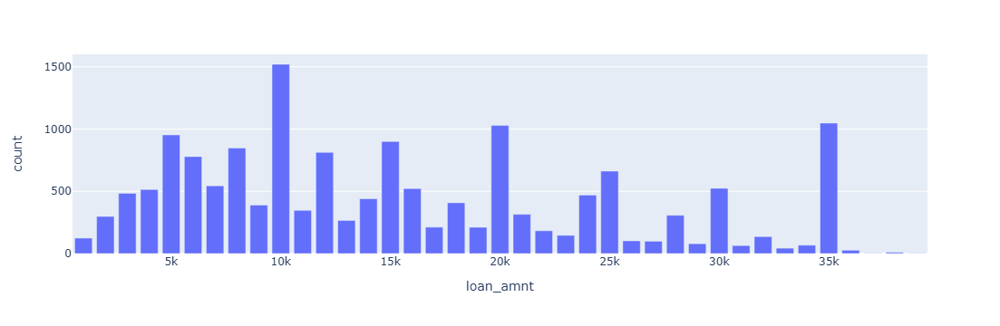

In [110]:
#visualize the loan amount
counts, bins = np.histogram(df.loan_amnt, bins=range(min, max, 1000))
bins = 0.5 * (bins[:-1] + bins[1:])

fig = px.bar(x=bins, y=counts, labels={'x':'loan_amnt', 'y':'count'})
fig.show()


from above, we can tell the majority of loans fall betwen 5K to 35K. $10K is the most common loan amount.

In [111]:
min_int = df_cleaned['int_rate'].min()
min_int = int(min_int)-1
min_int

4

In [112]:
max_int = df_cleaned['int_rate'].max()
max_int = int(max_int)+1
max_int

31

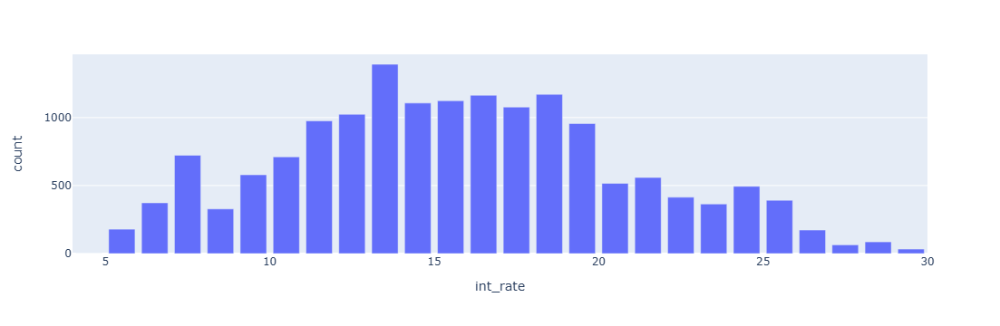

In [113]:
#visualize the interest rates for loans
counts, bins = np.histogram(df.int_rate, bins=range(min_int, max_int, 1))
bins = 0.5 * (bins[:-1] + bins[1:])

fig = px.bar(x=bins, y=counts, labels={'x':'int_rate', 'y':'count'})
fig.show()

We can tell from the above, the interest rates mainly fall between 10% to 20%. with majority of the interest rates fall at 13.5%.

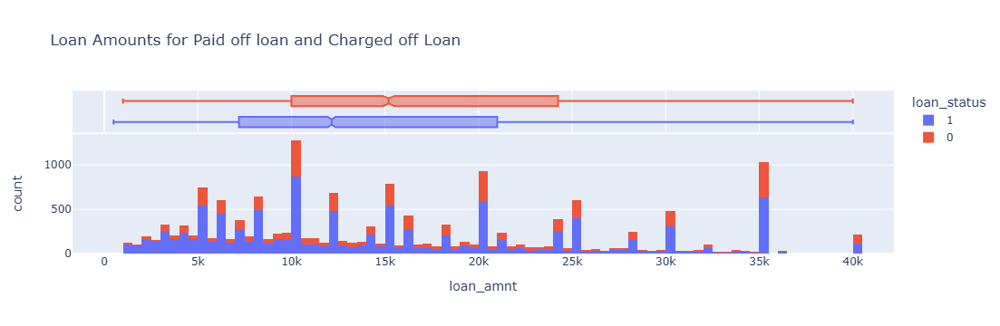

In [69]:
#compare the paid off loan(blue) and charge off loan(red) amounts
fig = px.histogram(df_cleaned, x="loan_amnt", color="loan_status", marginal="box", 
                   title='Loan Amounts for Paid off loan and Charged off Loan',
                         hover_data=df_cleaned.columns)
fig.show()

Based on above, the min, median and max values of charged off loans are all higher than the paid off loans. 

C:\Users\dfzdf\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.



Text(0.5, 1.0, 'Interest rates for Paid off loans and charged off loans')

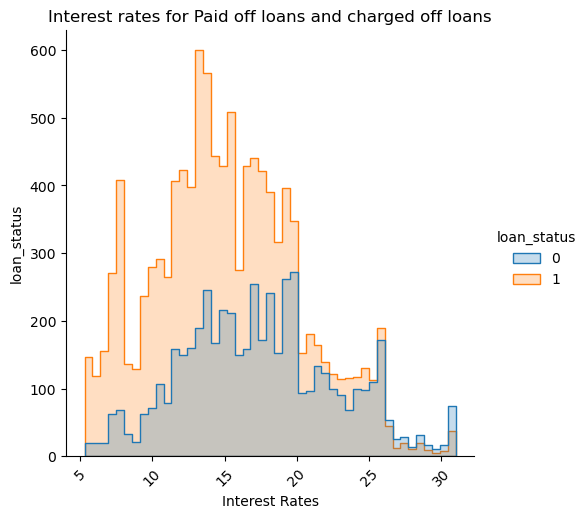

In [87]:
sns.displot(df_cleaned, x='int_rate', hue='loan_status', element="step")
plt.xticks(rotation=45)
plt.xlabel('Interest Rates')
plt.ylabel('loan_status')
plt.title('Interest rates for Paid off loans and charged off loans')


Orange represents the paid off loan while the blue ones represent the charged off loans. 
we can tell the paid off loans are more sknewed towards lower interest rates area while the charged off loans have more towards the higher interest rates.

Now let's look at the correlations

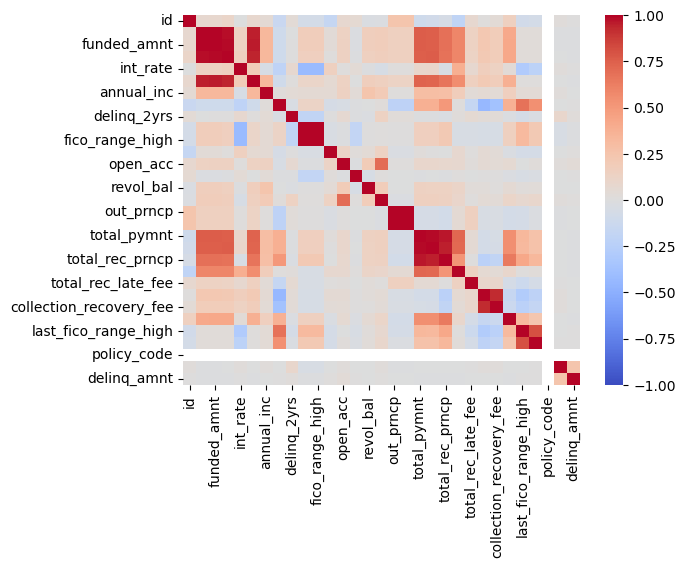

In [66]:
sns.heatmap(df_cleaned.corr(numeric_only=True), center=0, vmin=-1, vmax=1,fmt=".2f",cmap='coolwarm')
plt.show()

There are too many columns to run a heatmap, so we have to reduce columns and convert categorical variable to numerical variable

In [114]:
df_cleaned['term'].value_counts()

term
 36 months    12332
 60 months     3766
Name: count, dtype: int64

In [119]:
df_cleaned['term'] = df_cleaned['term'].replace({'36 months': 36, '60 months': 60})

C:\Users\dfzdf\AppData\Local\Temp\ipykernel_32280\2481163188.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [121]:
df_cleaned['home_ownership'].value_counts()

home_ownership
RENT        7225
MORTGAGE    7122
OWN         1730
OTHER         14
ANY            7
Name: count, dtype: int64

In [122]:
df_cleaned['home_ownership'] = df_cleaned['home_ownership'].map({'RENT': 0, 'MORTGAGE':1, 'OWN':2,'OTHER':0,'ANY':0},)

C:\Users\dfzdf\AppData\Local\Temp\ipykernel_32280\2065225618.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [123]:
df_cleaned['application_type'].value_counts()

application_type
Individual    15798
Joint App       300
Name: count, dtype: int64

In [124]:
df_cleaned['application_type'] = df_cleaned['application_type'].map({'Individual': 0, 'Joint App':1},)

C:\Users\dfzdf\AppData\Local\Temp\ipykernel_32280\2252914882.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [125]:
df_cleaned.head()

,id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,home_ownership,...,last_pymnt_amnt,last_fico_range_high,last_fico_range_low,policy_code,application_type,acc_now_delinq,delinq_amnt,hardship_flag,disbursement_method,debt_settlement_flag
0,68355089,24700.0,24700.0,24700.0,NaN,11.99,820.28,C,C1,1,...,926.35,699.0,695.0,1.0,0,0.0,0.0,N,Cash,N
1,67715283,16000.0,16000.0,16000.0,NaN,12.88,538.18,C,C2,1,...,565.09,629.0,625.0,1.0,0,0.0,0.0,N,Cash,N
2,68525638,14000.0,14000.0,14000.0,NaN,19.89,370.06,E,E3,1,...,14190.96,719.0,715.0,1.0,0,0.0,0.0,N,Cash,N
3,68536927,10000.0,10000.0,10000.0,NaN,11.48,329.67,B,B5,1,...,346.15,584.0,580.0,1.0,0,0.0,0.0,N,Cash,N
4,68566111,10000.0,10000.0,10000.0,NaN,19.48,262.06,E,E2,1,...,8126.54,639.0,635.0,1.0,0,0.0,0.0,N,Cash,N


In [131]:
df_cleaned['grade'].value_counts()

grade
C    4113
D    3745
B    2666
E    2412
A    1485
F    1162
G     515
Name: count, dtype: int64

In [132]:
df_cleaned['grade'] = df_cleaned['grade'].map({'A': 0, 'B':1,'C':2,'D':3,'E':4,'F':5,'G':6,})

C:\Users\dfzdf\AppData\Local\Temp\ipykernel_32280\1313157378.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [138]:
related_columns = ['loan_status','loan_amnt', 'int_rate', 'grade', 'home_ownership','application_type','last_pymnt_amnt','last_fico_range_high',
                  'acc_now_delinq']
correlation_matrix = df_cleaned[related_columns].corr()



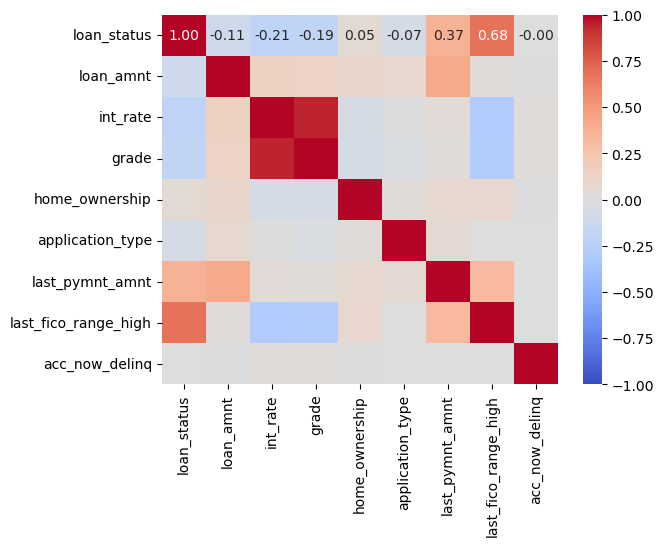

In [139]:
sns.heatmap(correlation_matrix, annot = True, center=0, vmin=-1, vmax=1,fmt=".2f",cmap='coolwarm')
plt.show()

From the heatmap above, we can see the whether a business can payoff its loan is highly related to the Fico Score and last payment amount.
negatively related to the loan amounts and interest rates and grades.